In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import torch
from torch import nn
import deeplake
from torchvision import transforms, models, datasets
import flask
from deeplake.core.vectorstore.deeplake_vectorstore import VectorStore
import os
import torch
from torchvision.models.feature_extraction import create_feature_extractor
from PIL import Image

/Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: 'dlopen(/Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/torchvision/image.so, 0x0006): Symbol not found: __ZN3c1017RegisterOperatorsD1Ev
  Referenced from: <2BDBC688-E93D-38EE-BBB2-E3BEEEAB3977> /Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/torchvision/image.so
  Expected in:     <F37A8933-BE2B-34BD-AE9A-CEE18F73F614> /Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/torch/lib/libtorch_cpu.dylib'If you don't plan on using image functionality from `torchvision.io`, you can ignore this warning. Otherwise, there might be something wrong with your environment. Did you have `libjpeg` or `libpng` installed before building `torchvision` from source?
  warn(
/Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found.

# Initial Tests

In [2]:
# Imports
from torchvision.models.segmentation import fcn_resnet50, FCN_ResNet50_Weights
from torchvision.transforms.functional import to_pil_image
import torchvision

# Load the image
img = Image.open('../data/test-images/jordan.jpg')

image_copy = img.copy()
x = torchvision.transforms.functional.to_tensor(img)

# From https://pytorch.org/vision/stable/models.html#semantic-segmentation
# Load weights
weights = FCN_ResNet50_Weights.DEFAULT
model = fcn_resnet50(weights=weights, pretrained=True)

# Set the model to evaluation mode
preprocess = weights.transforms()

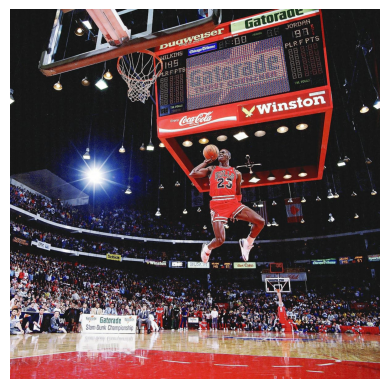

In [3]:
plt.imshow(img)
plt.axis('off')
plt.show()

In [4]:
batch = preprocess(x).unsqueeze(0)

# Perform inference
prediction = model(batch)['out']
normalized_masks = prediction.softmax(dim=1)

/Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


/var/folders/hg/dd3yfd8j7vx8qtmvm42400j80000gn/T/ipykernel_37341/2966475622.py:14: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  numpy_mask = torch.tensor(mask).numpy()


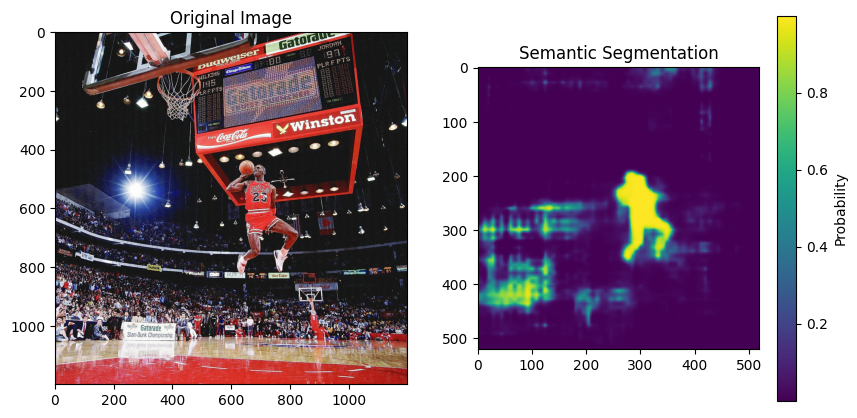

In [5]:
class_to_idx = {cls: idx for (idx, cls) in enumerate(weights.meta["categories"])}
mask = normalized_masks[0, class_to_idx["person"]]
pil_semantic = to_pil_image(mask)

fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].imshow(x.permute(1, 2, 0))
ax[1].imshow(pil_semantic)

# Add titles
ax[0].set_title('Original Image')
ax[1].set_title('Semantic Segmentation')

# Add colorbar
numpy_mask = torch.tensor(mask).numpy()
cbar = plt.colorbar(ax[1].imshow(numpy_mask, cmap='viridis'), ax=ax[1])
cbar.set_label('Probability')
plt.show()

# Create Highlighting Function

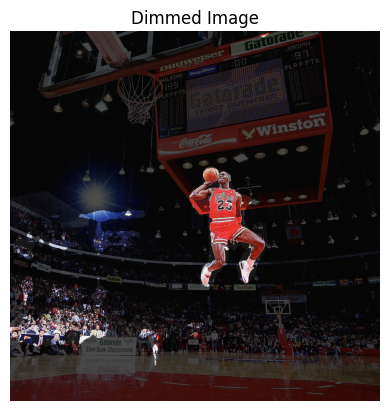

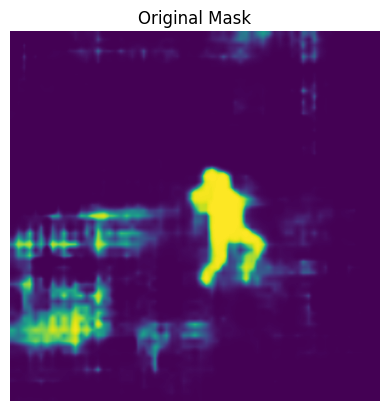

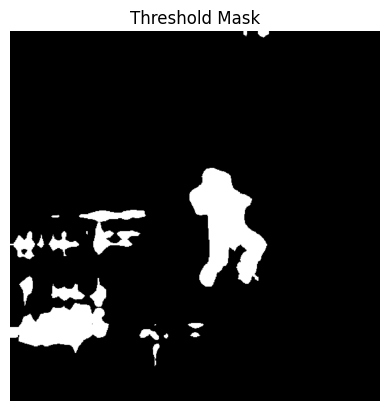

In [40]:
# Function that takes in an image and returns the dimmed image
def person_highlighter(image_path, threshold=0.5, dimming_factor=0.3, all_images=False):
    img = Image.open(image_path)
    image_copy = img.copy()
    x = torchvision.transforms.functional.to_tensor(img)

    # Load weights
    weights = FCN_ResNet50_Weights.DEFAULT
    model = fcn_resnet50(weights=weights, pretrained=True)

    # Set the model to evaluation mode
    preprocess = weights.transforms()

    batch = preprocess(x).unsqueeze(0)

    # Perform inference
    prediction = model(batch)["out"]
    normalized_masks = prediction.softmax(dim=1)

    class_to_idx = {cls: idx for (idx, cls) in enumerate(weights.meta["categories"])}
    original_mask = normalized_masks[0, class_to_idx["person"]]

    # Add zeroes to the mask so it's the same size as the image
    mask = (
        torch.nn.functional.interpolate(
            original_mask.unsqueeze(0).unsqueeze(0),
            size=(img.height, img.width),
            mode="nearest",
        )
        .squeeze(0)
        .squeeze(0)
    )

    # Convert the mask to a numpy array
    mask = mask.detach().numpy()

    person_mask = mask > threshold

    dimmed_img = image_copy.copy()

    # Make dimmed img the same size as the person mask
    dimmed_img = np.array(img)

    # Multiply the dimmed image by the mask

    # This is much faster but struggles with certain sized photos

    ### TODO: Make this work with any size photo by adding 0 padding to the mask
    try:
        dimmed_img[~person_mask] = dimmed_img[~person_mask] * dimming_factor

    except IndexError:

        for y in range(img.size[1]):
            for x in range(img.size[0]):
                if not person_mask[y, x]:
                    dimmed_img[y, x] = dimmed_img[y, x] * dimming_factor

    # If all images, Return threshold mask, mask, and dimmed image
    if all_images:
        return (
            to_pil_image(original_mask),
            Image.fromarray(person_mask),
            Image.fromarray(dimmed_img),
        )

    # Return only the dimmed image
    else:
        return Image.fromarray(dimmed_img)


# Test the function
original_mask, threshold_mask, dimmed_img = person_highlighter(
    "../data/test-images/jordan.jpg", threshold=0.4, dimming_factor=0.3, all_images=True
)
plt.imshow(dimmed_img)
plt.title("Dimmed Image")
plt.axis("off")
plt.show()

plt.imshow(original_mask)
plt.title("Original Mask")
plt.axis("off")
plt.show()

plt.imshow(threshold_mask)
plt.title("Threshold Mask")
plt.axis("off")
plt.show()

## Applied to test photos

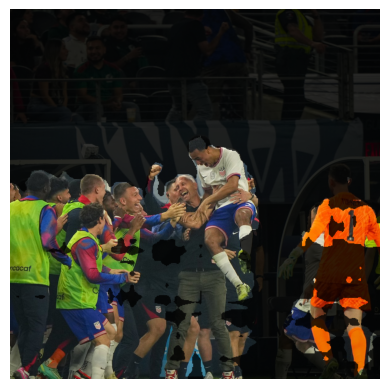

In [94]:
dimmed_img = person_highlighter('../data/test-images/tyler_adams.jpg', threshold=0.2, dimming_factor=0.2)
plt.imshow(dimmed_img)
plt.axis('off')
plt.show()

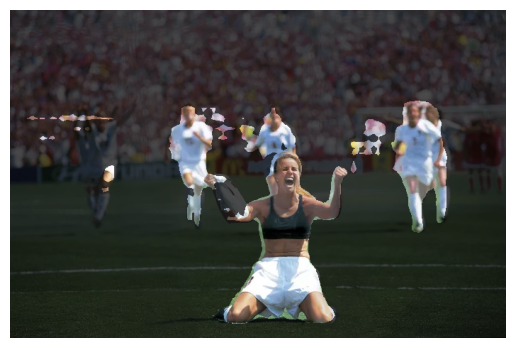

In [95]:
dimmed_img = person_highlighter('../data/test-images/hamm.jpg', threshold=0.5, dimming_factor=0.3)
plt.imshow(dimmed_img)
plt.axis('off')
plt.show()

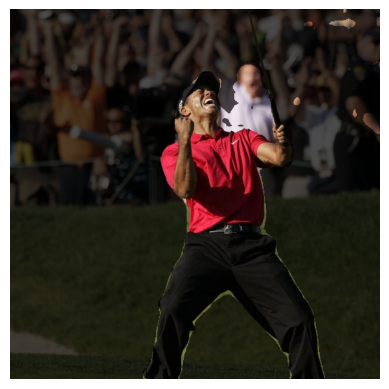

In [96]:
dimmed_img = person_highlighter('../data/test-images/tiger.jpg', threshold=0.5, dimming_factor=0.3)
plt.imshow(dimmed_img)
plt.axis('off')
plt.show()

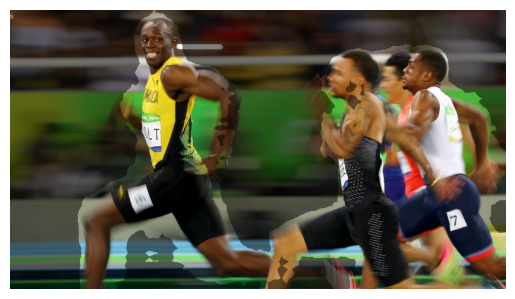

In [97]:
dimmed_img = person_highlighter('../data/test-images/bolt.jpg', threshold=0.01, dimming_factor=0.5)
plt.imshow(dimmed_img)
plt.axis('off')
plt.show()

## Applied to art

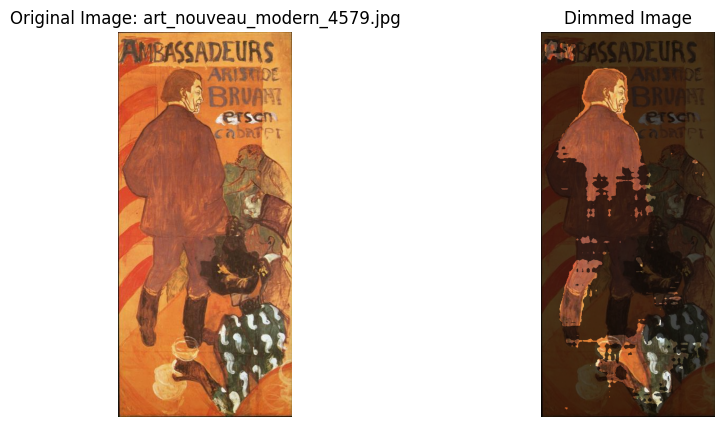

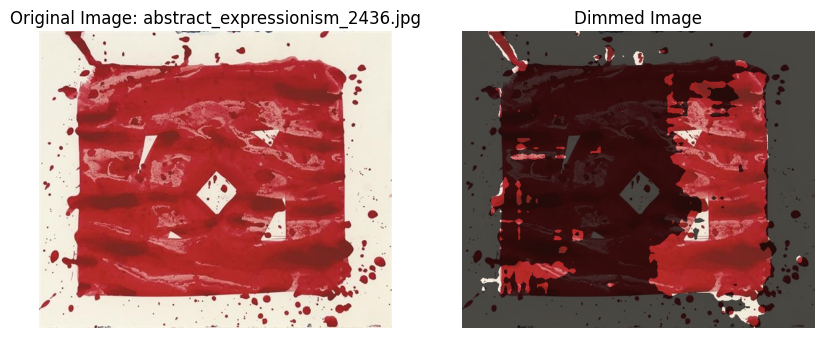

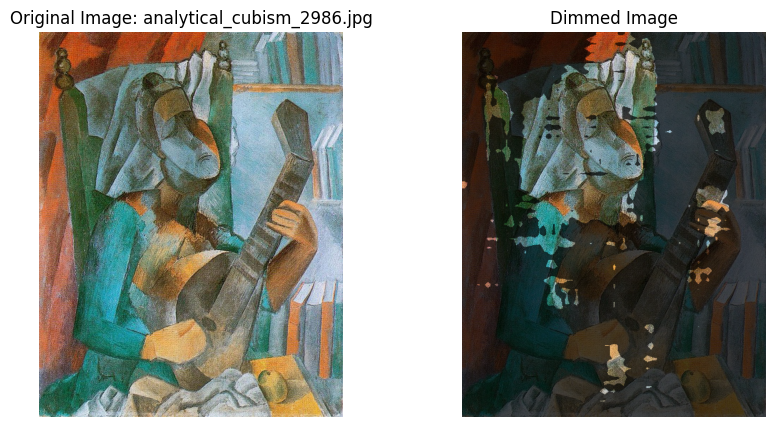

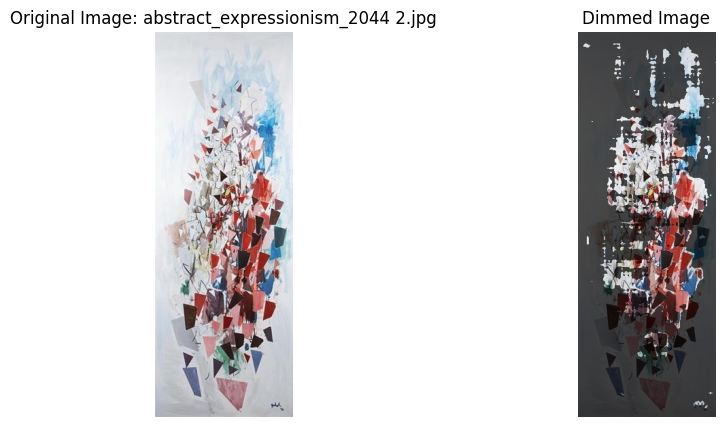

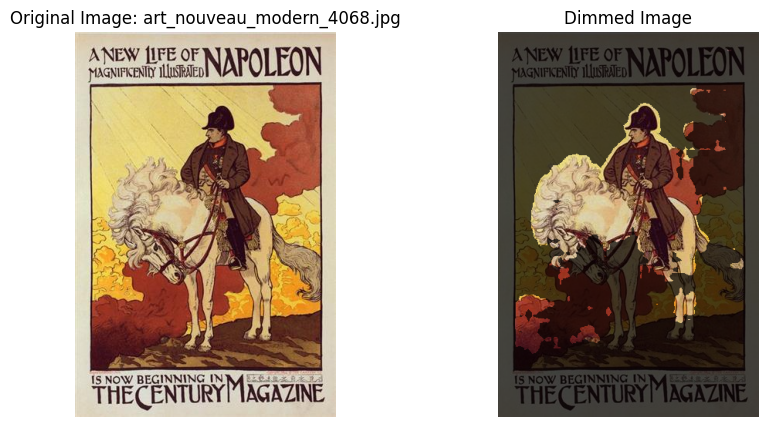

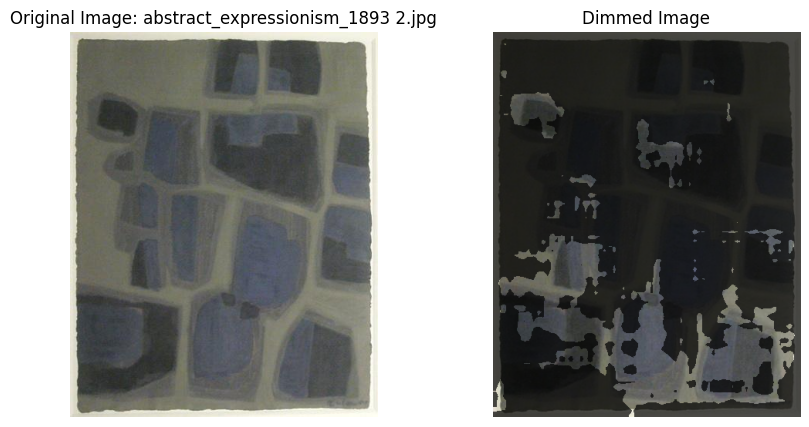

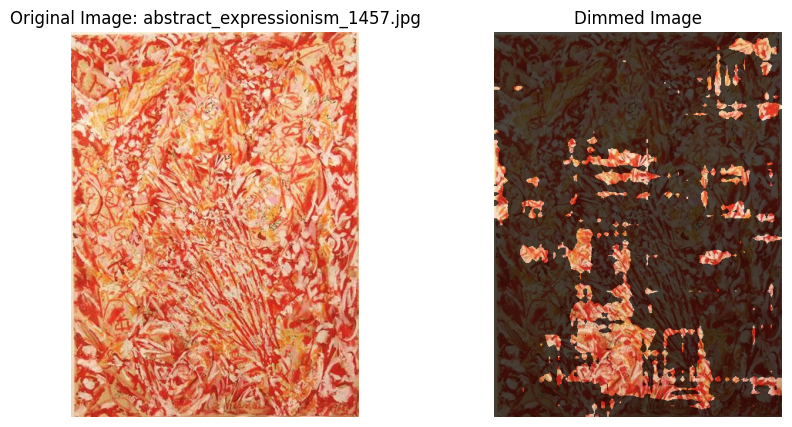

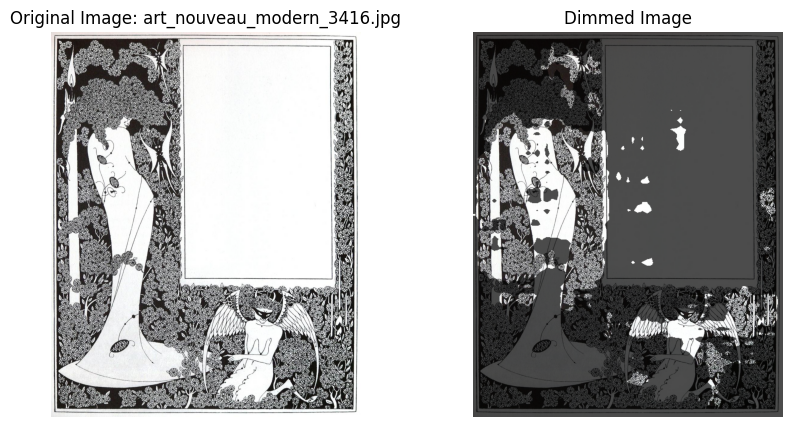

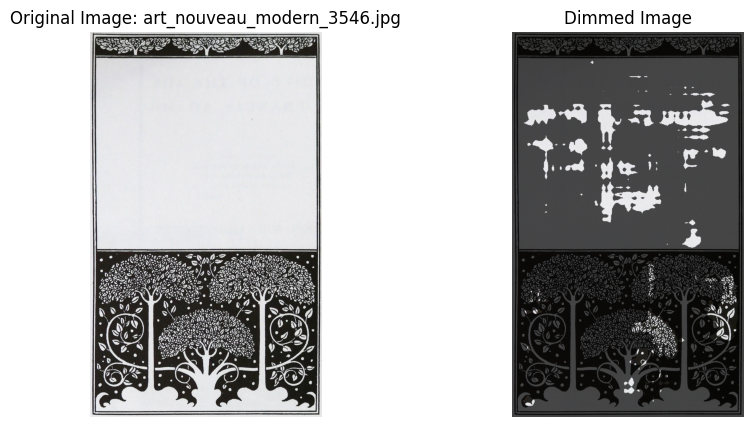

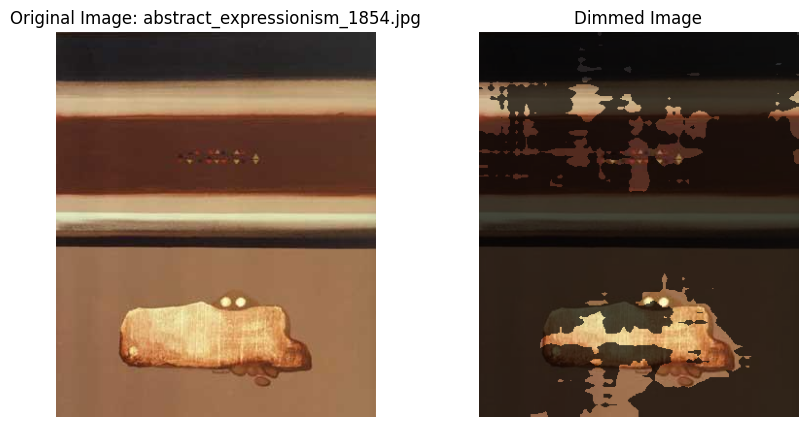

In [98]:
# Pick 10 random images from the images folder
images_fn = os.listdir('./images/')
images_10 = np.random.choice(images_fn, 10, replace=False)

# Add the path to the images
images_10 = ['./images/' + i for i in images_10]


# Plot the images
for i, path in enumerate(images_10):
    img = Image.open(path)
    dimmed_img = person_highlighter(path, threshold=0.1, dimming_factor=0.3) # Art is more abstract, so we need to lower the threshold
    fig, ax = plt.subplots(1, 2, figsize=(10, 5))
    ax[0].imshow(img)
    ax[1].imshow(dimmed_img)
    ax[0].axis('off')
    ax[1].axis('off')
    image_name = path.split('/')[-1]
    ax[0].set_title('Original Image: ' + image_name)
    ax[1].set_title('Dimmed Image')
    plt.show()

# TODO:
- [x] Apply to test and art photos
- [x] Try ResNet18 on the segmented photos and compare the results to the original photos


# Testing Each Mask Style

## Create Masks

### Load Data

In [99]:
# Load WikiArt
ds = deeplake.load('hub://activeloop/wiki-art')


# Create transform
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

dataloader = ds.pytorch(transform=transform, batch_size=32, shuffle=True, tensors=['images', 'labels'])

Opening dataset in read-only mode as you don't have write permissions.


\

This dataset can be visualized in Jupyter Notebook by ds.visualize() or at https://app.activeloop.ai/activeloop/wiki-art



-

hub://activeloop/wiki-art loaded successfully.



/Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/deeplake/integrations/pytorch/common.py:137: UserWarning: Decode method for tensors ['images'] is defaulting to numpy. Please consider specifying a decode_method in .pytorch() that maximizes the data preprocessing speed based on your transformation.
  warnings.warn(


### New Loading Format to get more diverse styles

In [ ]:
from tqdm import tqdm

# Empty images folder
if os.path.exists('images'):
    os.system('rm -rf images')

# Create images folder
os.system('mkdir images')

# Make a styles counter
styles = {}

# Downloads counter for saved images
downloads = 0

# Save images
print('Saving images...')
for i, sample in enumerate(tqdm(ds)):

    # Make sure i is an integer for indexing
    i = int(i)

    # Save image
    image = sample.images.numpy()
    label = sample.labels.data()['text'][0]

    # Add to styles counter
    if label in styles:
        # If the style already has 1000 images, skip to get a more balanced dataset
        if styles[label] > 1000:
            continue
        styles[label] += 1
    else:
        styles[label] = 1


    # Save image
    plt.imsave(f'images/{label}_{i}.jpg', image)

    # Increment downloads
    downloads += 1

    # Print downloads every 1000 images
    if downloads % 1000 == 0:
        print('Downloads: ', downloads)

    # Once we have 5000 images, break
    if downloads >= 5000:
        break
    
print('Done saving images')
print("Total images saved: ", len(os.listdir('./images')))

print("Image Style Counts:")
for k, v in styles.items():
    print(f"{k}: {v}")

*Outputs cleared but the functions should work*

### Create Masks

In [4]:
# Make dimmed_images, masks, and threshold-masks folders

# Check if the folders exist
if os.path.exists('dimmed_images'):
    os.system('rm -rf dimmed_images')
if os.path.exists('masks'):
    os.system('rm -rf masks')
if os.path.exists('threshold-masks'):
    os.system('rm -rf threshold-masks')


# Create the folders
os.system('mkdir dimmed_images')
os.system('mkdir masks')
os.system('mkdir threshold-masks')

0

In [6]:
from tqdm import tqdm

# Function to save images to each folder
def save_masks(path, threshold=0.2, dimming_factor=0.3):
    original_mask, threshold_mask, dimmed_img = person_highlighter(path, threshold=threshold, dimming_factor=dimming_factor, all_images=True)
    image_name = path.split('/')[-1]
    dimmed_img.save(f'dimmed_images/{image_name}')
    original_mask.save(f'masks/{image_name}')
    threshold_mask.save(f'threshold-masks/{image_name}')

# Get the paths to the images
images_fn = os.listdir('./images/')

# Add the path to the images
images_fn = ['./images/' + i for i in images_fn]

# Save the images
### Tried to do this in parallel but it was barely faster and more error prone
print('Saving images...')
for path in tqdm(images_fn):
    try:
        save_masks(path, threshold=0.1, dimming_factor=0.3)
    except Exception as e:
        print("Failed to save image: ", path, "with error: ", e)


Saving images...


  0%|          | 0/5000 [00:00<?, ?it/s]

/Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(
  8%|▊         | 392/5000 [27:57<5:07:28,  4.00s/it] /Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/PIL/Image.py:3186: DecompressionBombWarning: Image size (107327830 pixels) exceeds limit of 89478485 pixels, could be decompressio

KeyboardInterrupt: 

**I stopped after 1000 images because it was taking too long. We will need to do this on colab or Landon's GPU**

In [7]:
# Print the number of images in each folder
print("Dimmed Images: ", len(os.listdir('./dimmed_images')))
print("Masks: ", len(os.listdir('./masks')))
print("Threshold Masks: ", len(os.listdir('./threshold-masks')))
print("Total Images: ", len(images_fn))

Dimmed Images:  1000
Masks:  1000
Threshold Masks:  1000
Total Images:  5000


## Create Model

Same as in [deeplake-resnet-test.ipynb](deeplake-resnet-test.ipynb)

In [9]:
from torchvision.models.feature_extraction import create_feature_extractor

# Check if GPU is available
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# Load the model
model = models.resnet18(pretrained=True)

# Create a feature extractor
return_nodes = {
    'avgpool': 'embedding'
}
model = create_feature_extractor(model, return_nodes=return_nodes)

# Freeze the model
model.eval()
model.to(device)

# Image transformation
# From https://docs.activeloop.ai/example-code/tutorials/vector-store/image-similarity-search
tform= transforms.Compose([
    transforms.Resize((224,224)), 
    transforms.ToTensor(),
    transforms.Lambda(lambda x: torch.cat([x, x, x], dim=0) if x.shape[0] == 1 else x),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
])

# From https://docs.activeloop.ai/example-code/tutorials/vector-store/image-similarity-search
def embedding_function(images, model = model, transform = tform, batch_size = 4):
    """Creates a list of embeddings based on a list of image filenames. Images are processed in batches."""

    if isinstance(images, str):
        images = [images]

    # Proceess the embeddings in batches, but return everything as a single list
    embeddings = []
    for i in range(0, len(images), batch_size):
        batch = torch.stack([transform(Image.open(item)) for item in images[i:i+batch_size]])
        batch = batch.to(device)
        with torch.no_grad():
            embeddings+= model(batch)['embedding'][:,:,0,0].cpu().numpy().tolist()

    return embeddings

from deeplake.core.vectorstore.deeplake_vectorstore import VectorStore

# Path to the dimmed vector store
dimmed_vector_store_path = 'dimmed_vector_store/'
mask_vector_store_path = 'mask_vector_store/'
threshold_mask_vector_store_path = 'threshold_mask_vector_store/'

# Empty the vector store
## Will get an error if it has anything in it
if os.path.exists(dimmed_vector_store_path):
    os.system(f'rm -r {dimmed_vector_store_path}')
os.makedirs(dimmed_vector_store_path)

# Create the vector stores
dimmed_vector_store = VectorStore(
    path = dimmed_vector_store_path,
    tensor_params = [{'name': 'image', 'htype': 'image', 'sample_compression': 'jpg'}, 
                     {'name': 'embedding', 'htype': 'embedding'}, 
                     {'name': 'filename', 'htype': 'text'}],
)

mask_vector_store = VectorStore(
    path = mask_vector_store_path,
    tensor_params = [{'name': 'image', 'htype': 'image', 'sample_compression': 'jpg'}, 
                     {'name': 'embedding', 'htype': 'embedding'}, 
                     {'name': 'filename', 'htype': 'text'}],
)

threshold_mask_vector_store = VectorStore(
    path = threshold_mask_vector_store_path,
    tensor_params = [{'name': 'image', 'htype': 'image', 'sample_compression': 'jpg'}, 
                     {'name': 'embedding', 'htype': 'embedding'}, 
                     {'name': 'filename', 'htype': 'text'}],
)

/Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


## Apply Model to Art Images

In [10]:
dimmed_images_fn = os.listdir('./dimmed_images/')
masks_fn = os.listdir('./masks/')
threshold_masks_fn = os.listdir('./threshold-masks/')

# Add the path to the images
dimmed_images_fn = ['./dimmed_images/' + i for i in dimmed_images_fn]
masks_fn = ['./masks/' + i for i in masks_fn]
threshold_masks_fn = ['./threshold-masks/' + i for i in threshold_masks_fn]

print('Adding dimmed images to vector store...')
# Add dimmed images to the vector store
dimmed_vector_store.add(image = dimmed_images_fn,
                 filename = dimmed_images_fn,
                 embedding_function = embedding_function, 
                 embedding_data = dimmed_images_fn)

print('Adding masks to vector store...')
# Add masks to the vector store
mask_vector_store.add(image = masks_fn,
                 filename = masks_fn,
                 embedding_function = embedding_function, 
                 embedding_data = masks_fn)

print('Adding threshold masks to vector store...')
# Add threshold masks to the vector store
threshold_mask_vector_store.add(image = threshold_masks_fn,
                 filename = threshold_masks_fn,
                 embedding_function = embedding_function, 
                 embedding_data = threshold_masks_fn)


Adding dimmed images to vector store...


Creating 1000 embeddings in 2 batches of size 500::   0%|          | 0/2 [00:00<?, ?it/s]/Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/PIL/Image.py:3186: DecompressionBombWarning: Image size (107327830 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(
Creating 1000 embeddings in 2 batches of size 500:: 100%|██████████| 2/2 [00:53<00:00, 26.64s/it]


Dataset(path='dimmed_vector_store/', tensors=['image', 'embedding', 'filename', 'id'])

  tensor      htype                shape               dtype  compression
  -------    -------              -------             -------  ------- 
   image      image    (1000, 116:6911, 76:15530, 3)   uint8    jpeg   
 embedding  embedding           (1000, 512)           float32   None   
 filename     text               (1000, 1)              str     None   
    id        text               (1000, 1)              str     None   
Adding masks to vector store...


Creating 1000 embeddings in 2 batches of size 500::   0%|          | 0/2 [00:00<?, ?it/s]/Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/deeplake/core/chunk/base_chunk.py:422: UserWarning: Grayscale images will be reshaped from (H, W) to (H, W, 1) to match tensor dimensions. This warning will be shown only once.
  warnings.warn(message)
Creating 1000 embeddings in 2 batches of size 500:: 100%|██████████| 2/2 [00:48<00:00, 24.34s/it]


Dataset(path='mask_vector_store/', tensors=['image', 'embedding', 'filename', 'id'])

  tensor      htype                shape               dtype  compression
  -------    -------              -------             -------  ------- 
   image      image    (1000, 520:3662, 520:3062, 1)   uint8    jpeg   
 embedding  embedding           (1000, 512)           float32   None   
 filename     text               (1000, 1)              str     None   
    id        text               (1000, 1)              str     None   
Adding threshold masks to vector store...


Creating 1000 embeddings in 2 batches of size 500:: 100%|██████████| 2/2 [00:50<00:00, 25.04s/it]

Dataset(path='threshold_mask_vector_store/', tensors=['image', 'embedding', 'filename', 'id'])

  tensor      htype                shape               dtype  compression
  -------    -------              -------             -------  ------- 
   image      image    (1000, 116:6911, 76:15530, 1)   uint8    jpeg   
 embedding  embedding           (1000, 512)           float32   None   
 filename     text               (1000, 1)              str     None   
    id        text               (1000, 1)              str     None   


In [15]:
# Create dimmed-test-images, mask-test-images, and threshold-mask-test-images folders
# Check if the folders exist
if os.path.exists('../data/dimmed-test-images'):
    os.system('rm -rf ../data/dimmed-test-images')
if os.path.exists('../data/mask-test-images'):
    os.system('rm -rf ../data/mask-test-images')
if os.path.exists('../data/threshold-mask-test-images'):
    os.system('rm -rf ../data/threshold-mask-test-images')
    
# Create the folders
os.system('mkdir ../data/dimmed-test-images')
os.system('mkdir ../data/mask-test-images')
os.system('mkdir ../data/threshold-mask-test-images')

# Add test images to the folders
test_image_fns = os.listdir('../data/test-images/')

for img in tqdm(test_image_fns):
    path = f'../data/test-images/{img}'
    original_mask, threshold_mask, dimmed_img = person_highlighter(path, threshold=0.1, dimming_factor=0.3, all_images=True)
    image_name = path.split('/')[-1]
    dimmed_img.save(f'../data/dimmed-test-images/{image_name}')
    original_mask.save(f'../data/mask-test-images/{image_name}')
    threshold_mask.save(f'../data/threshold-mask-test-images/{image_name}')

  0%|          | 0/10 [00:00<?, ?it/s]/Users/Austin/opt/anaconda3/envs/dsan6600/lib/python3.10/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(
100%|██████████| 10/10 [00:45<00:00,  4.54s/it]


## Results

### Results With Masks

In [16]:
# Function to get results and plot them
## k = number of similar images to get
def get_results(image_path, vector_store, k=5):

    # Get results from vector store
    result = vector_store.search(embedding_data=image_path, embedding_function=embedding_function, k=k)

    # Get image name of the first image
    image_name = os.path.basename(image_path)

    # Plot one image and the 5 most similar images
    fig, ax = plt.subplots(1, k+1, figsize=(20, 4))
    ax[0].imshow(plt.imread(image_path))
    ax[0].set_title('Query Image: ' + image_name)
    ax[0].axis('off')

    for i in range(k):

        # Get image data
        label = result['filename'][i]

        label = label.rstrip('.jpg').split('/')[-1]
        
        # Remove any numbers
        label = ''.join([i for i in label if not i.isdigit()])

        # Remove any underscores
        label = label.replace('_', ' ')

        img = result['image'][i]
        similarity = result['score'][i]

        # Plot image
        ax[i+1].imshow(img)
        ax[i+1].set_title(f'Similar Image {i+1}\nType: {label}\nScore: {similarity:.3f}')
        ax[i+1].axis('off')

    # Show plot
    plt.show()

Results for image:  ../data/test-images/rodman.jpg
Dimmed Images Results


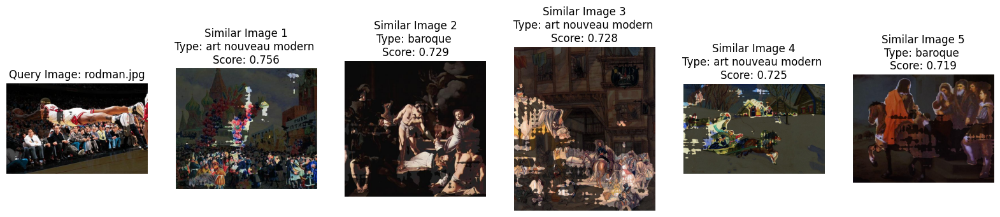

Masks Results


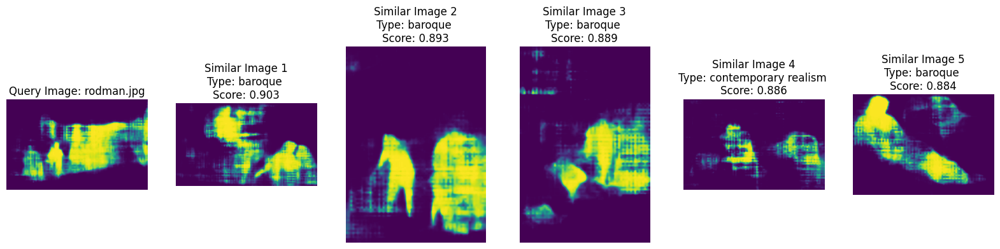

Threshold Masks Results


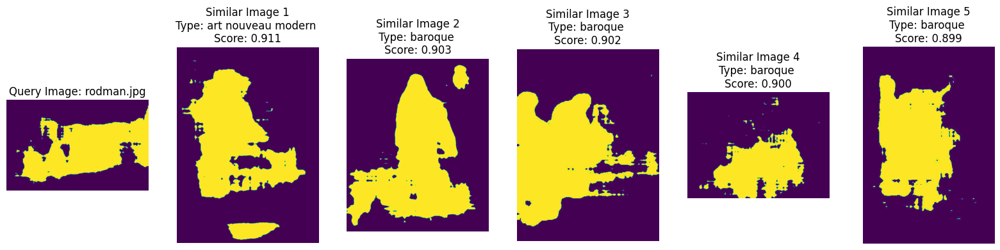

Results for image:  ../data/test-images/bolt.jpg
Dimmed Images Results


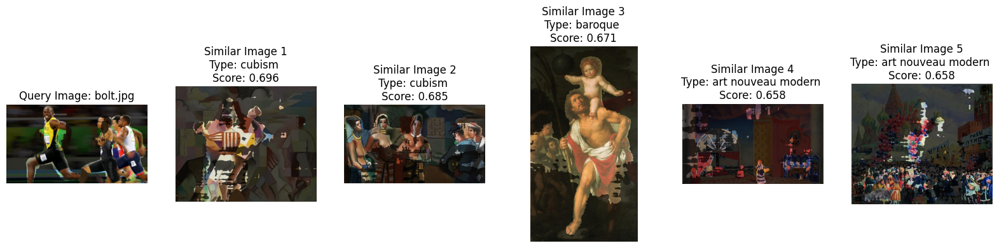

Masks Results


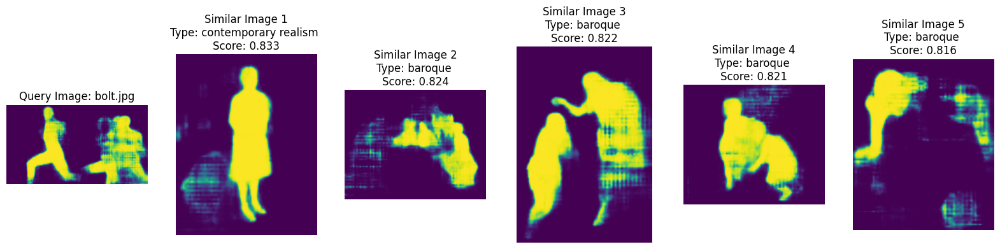

Threshold Masks Results


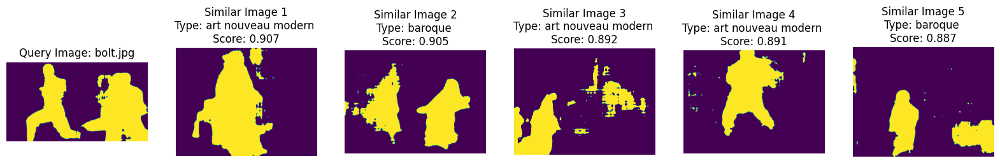

Results for image:  ../data/test-images/lance.jpg
Dimmed Images Results


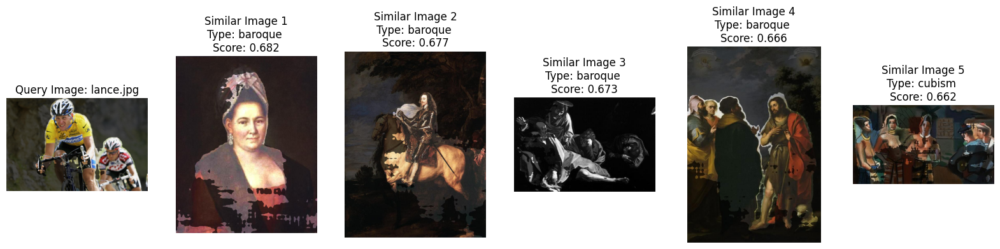

Masks Results


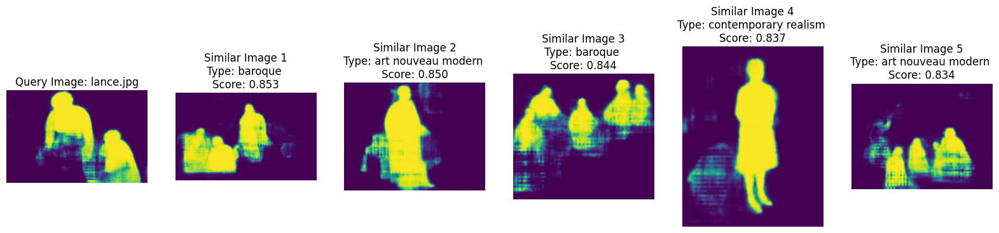

Threshold Masks Results


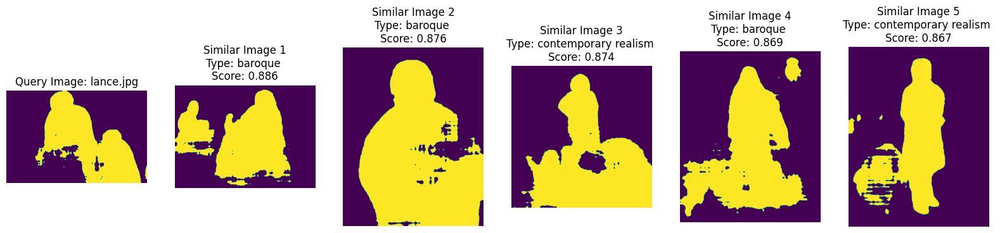

Results for image:  ../data/test-images/hamm.jpg
Dimmed Images Results


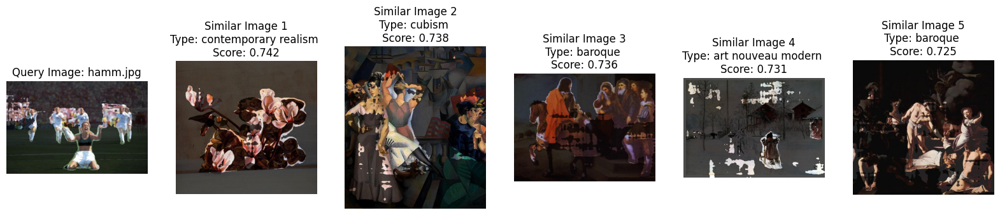

Masks Results


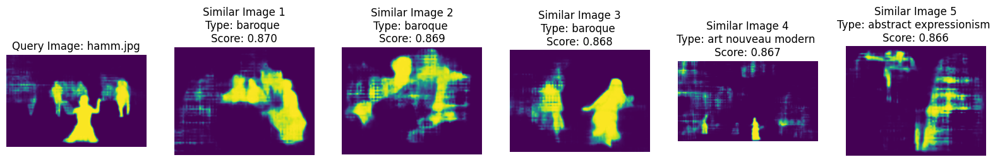

Threshold Masks Results


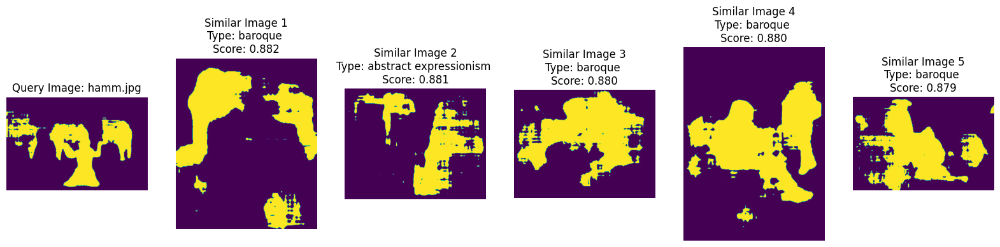

Results for image:  ../data/test-images/tiger.jpg
Dimmed Images Results


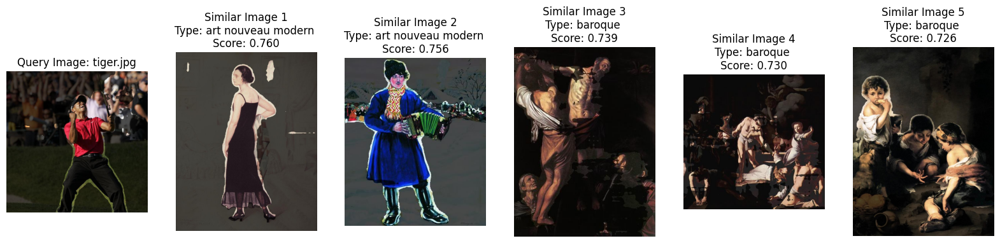

Masks Results


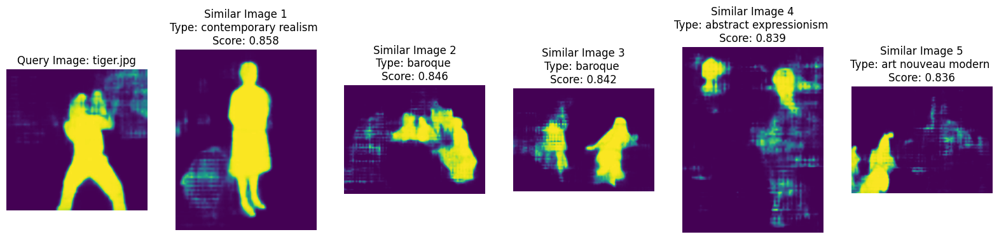

Threshold Masks Results


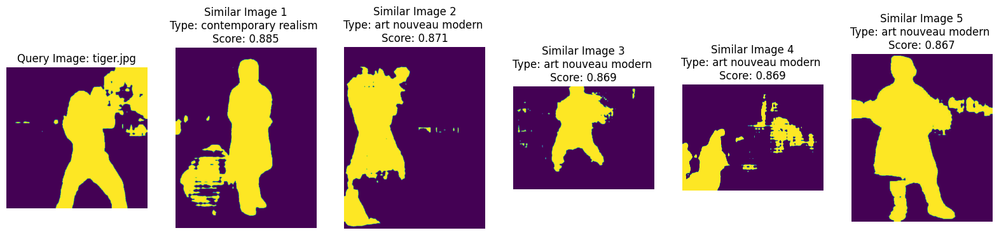

Results for image:  ../data/test-images/the_catch.jpg
Dimmed Images Results


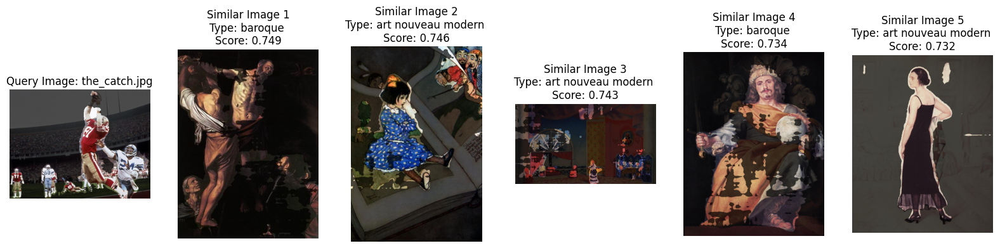

Masks Results


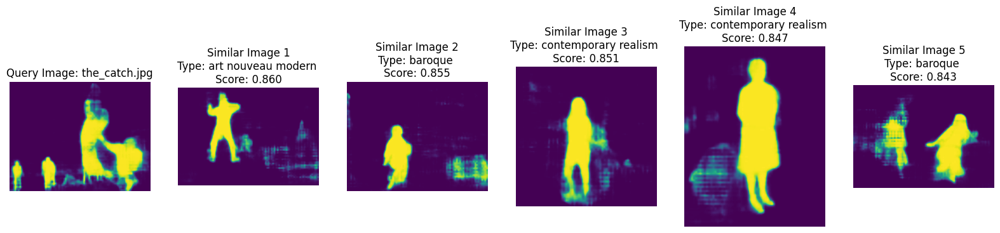

Threshold Masks Results


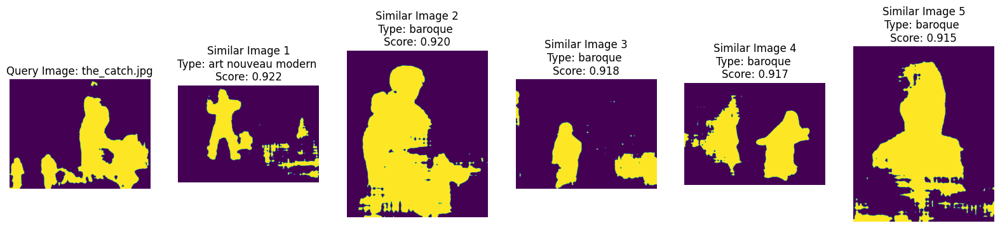

Results for image:  ../data/test-images/ali.jpg
Dimmed Images Results


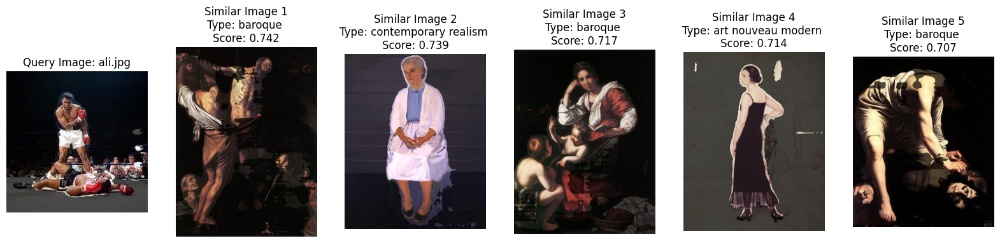

Masks Results


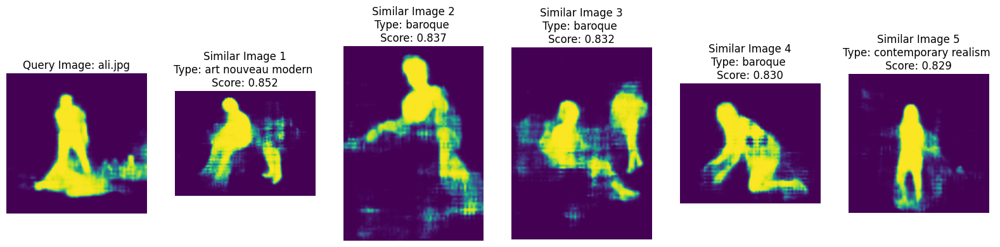

Threshold Masks Results


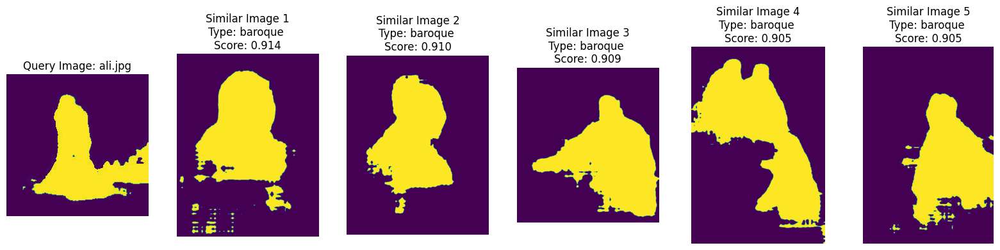

Results for image:  ../data/test-images/jokic.jpg
Dimmed Images Results


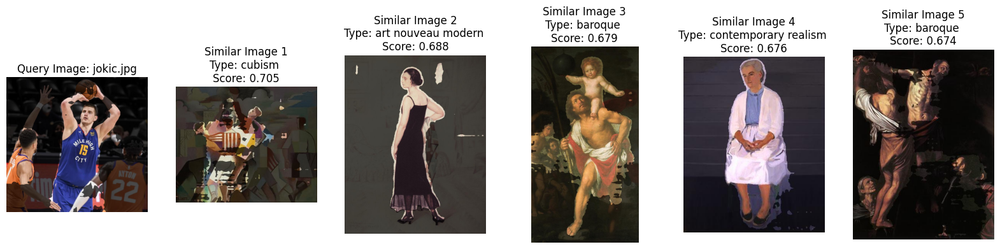

Masks Results


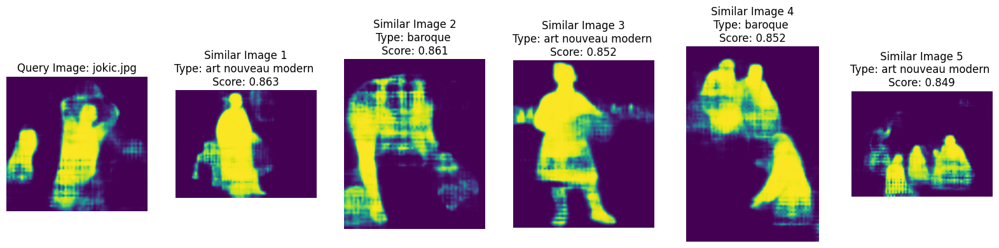

Threshold Masks Results


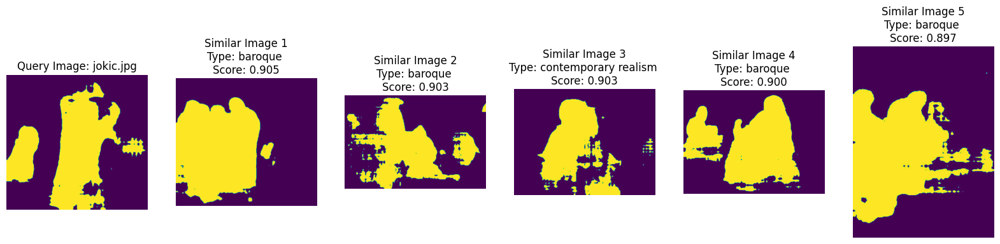

Results for image:  ../data/test-images/jordan.jpg
Dimmed Images Results


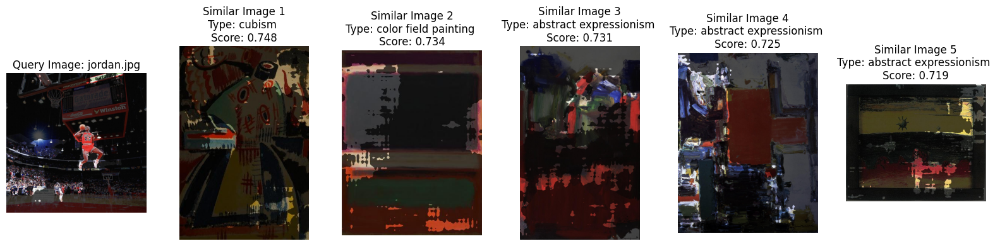

Masks Results


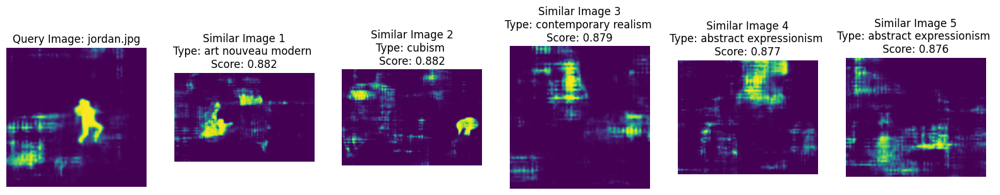

Threshold Masks Results


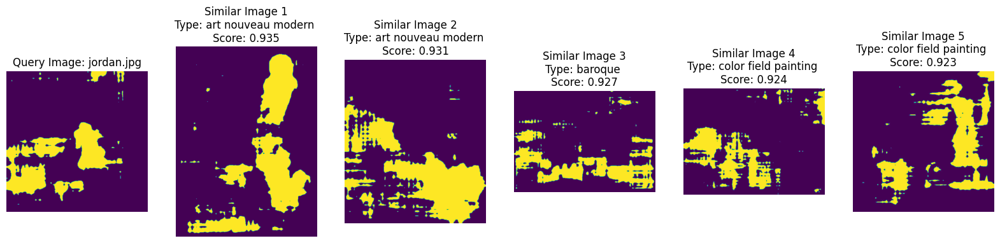

Results for image:  ../data/test-images/tyler_adams.jpg
Dimmed Images Results


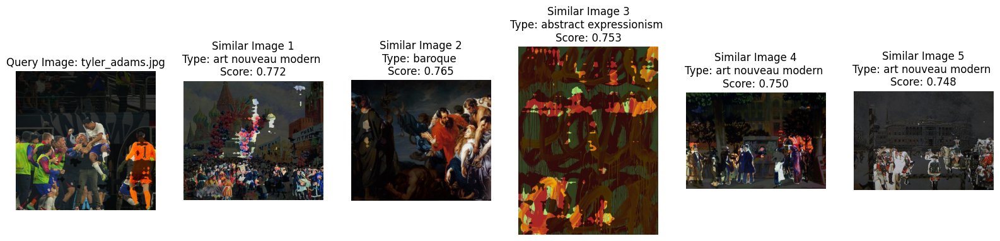

Masks Results


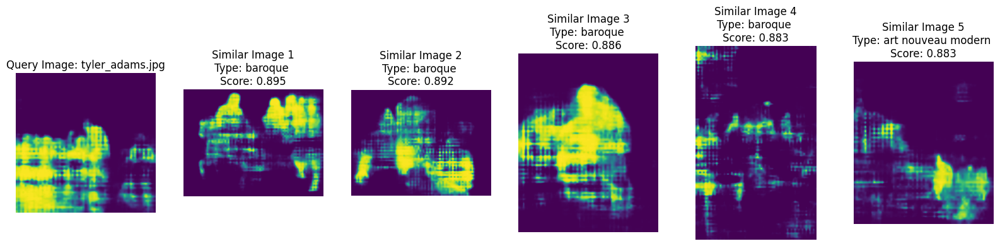

Threshold Masks Results


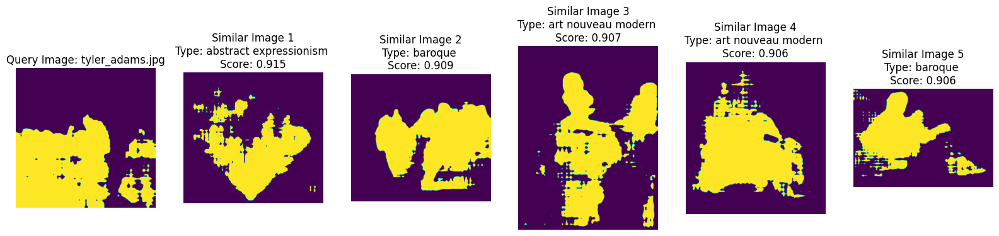

In [18]:
# Get images in test-images folder
test_images = [os.path.join('../data/test-images', item) for item in os.listdir('../data/test-images') if os.path.splitext(item)[-1]=='.jpg']

# Get results for each image
for image in test_images:
    print('Results for image: ', image)

    image_name = os.path.basename(image)
    dimmed_image_path = f'../data/dimmed-test-images/{image_name}'
    mask_image_path = f'../data/mask-test-images/{image_name}'
    threshold_mask_image_path = f'../data/threshold-mask-test-images/{image_name}'

    # Get results for dimmed images
    print("Dimmed Images Results")
    get_results(dimmed_image_path, dimmed_vector_store)
    
    # Get results for masks
    print("Masks Results")
    get_results(mask_image_path, mask_vector_store)

    # Get results for threshold masks
    print("Threshold Masks Results")
    get_results(threshold_mask_image_path, threshold_mask_vector_store)

This helps us get at what the model is looking at but is not what the final outputs would look like, we really want to compare image to art:

## Results as Original Images

In [35]:
# Function to get results and plot them while getting the original image from the images or test-images folder to compare the actual art
## k = number of similar images to get
def get_real_results(image_path, vector_store, k=5):

    # Get results from vector store
    result = vector_store.search(embedding_data=image_path, embedding_function=embedding_function, k=k)

    # Get image name of the first image
    image_name = os.path.basename(image_path)

    # Get the original image path
    image_name = image_name.split('/')[-1]
    image_path = f'../data/test-images/{image_name}'


    # Plot one image and the 5 most similar images
    fig, ax = plt.subplots(1, k+1, figsize=(20, 4))
    ax[0].imshow(plt.imread(image_path))
    ax[0].set_title('Query Image: ' + image_name)
    ax[0].axis('off')

    for i in range(k):

        # Get image data
        label = str(result['filename'][i])

        # Get actual image name
        original_path = label.split('/')[-1]
        original_path = f'./images/{original_path}'

        label = label.rstrip('.jpg').split('/')[-1]
        
        # Remove any numbers
        label = ''.join([i for i in label if not i.isdigit()])

        # Remove any underscores
        label = label.replace('_', ' ')

        img = plt.imread(original_path)
        similarity = result['score'][i]

        # Plot image
        ax[i+1].imshow(img)
        ax[i+1].set_title(f'Similar Image {i+1}\nType: {label}\nScore: {similarity:.3f}')
        ax[i+1].axis('off')

    # Show plot
    plt.show()

Results for image:  ../data/test-images/rodman.jpg
Dimmed Images Results


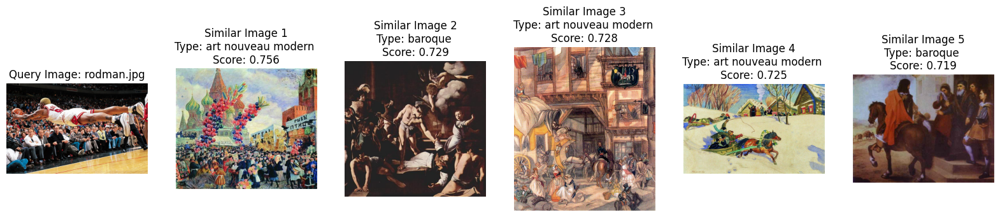

Masks Results


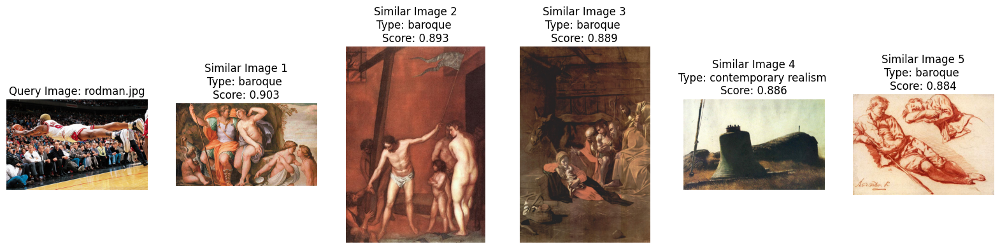

Threshold Masks Results


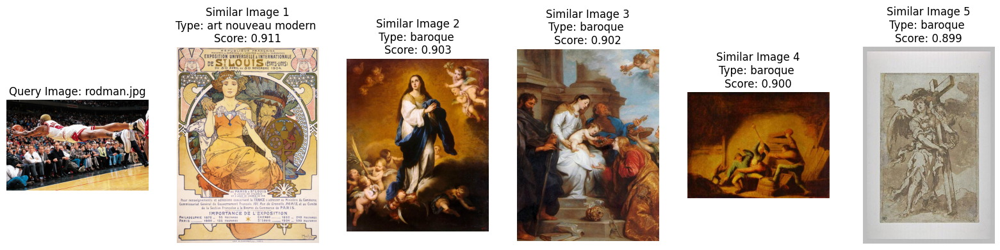

Results for image:  ../data/test-images/bolt.jpg
Dimmed Images Results


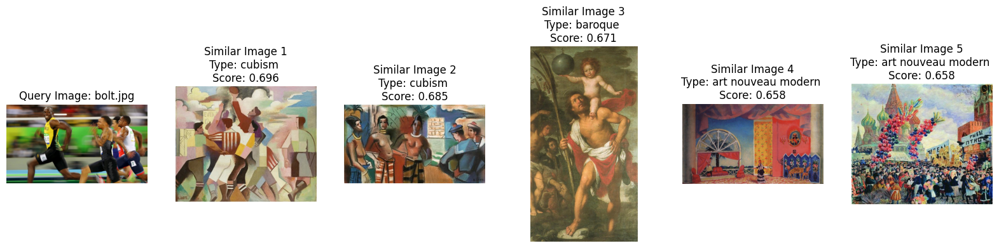

Masks Results


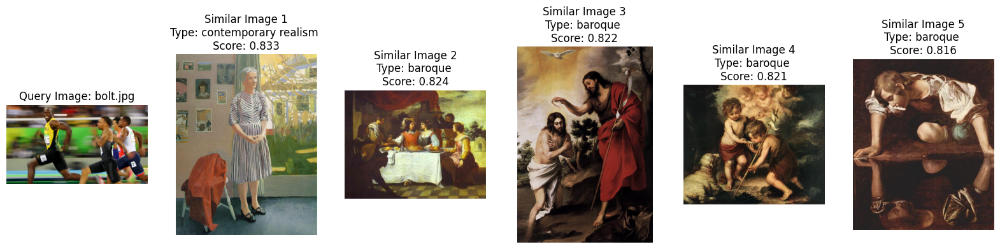

Threshold Masks Results


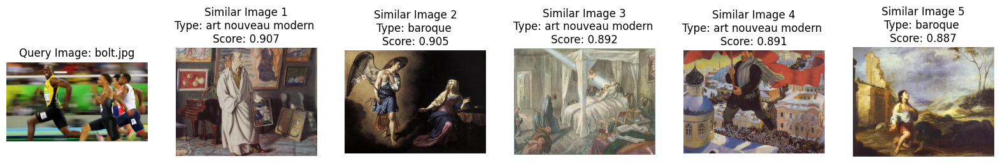

Results for image:  ../data/test-images/lance.jpg
Dimmed Images Results


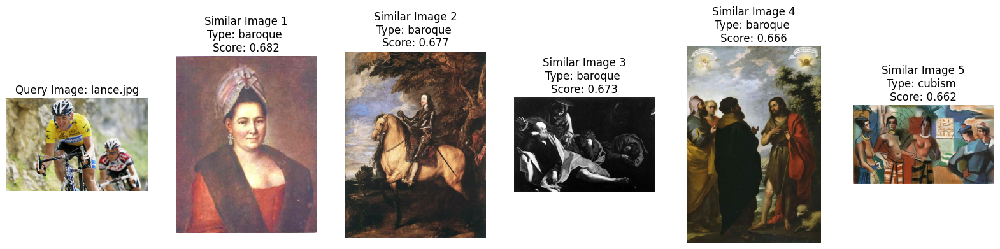

Masks Results


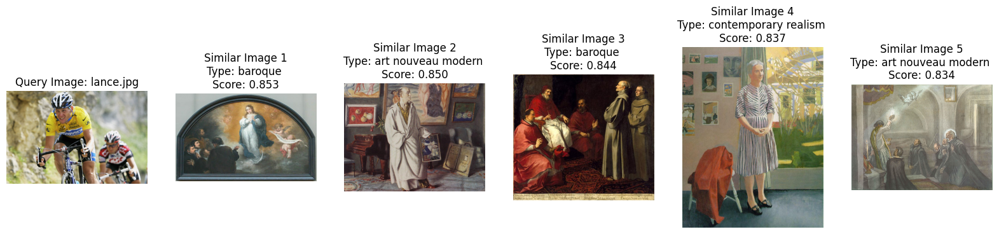

Threshold Masks Results


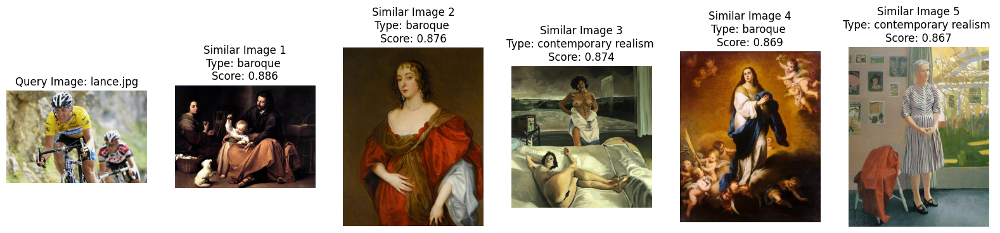

Results for image:  ../data/test-images/hamm.jpg
Dimmed Images Results


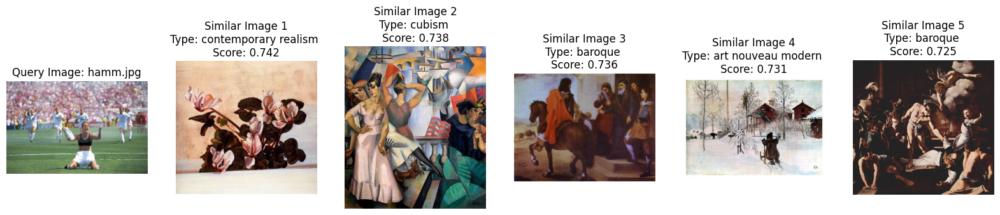

Masks Results


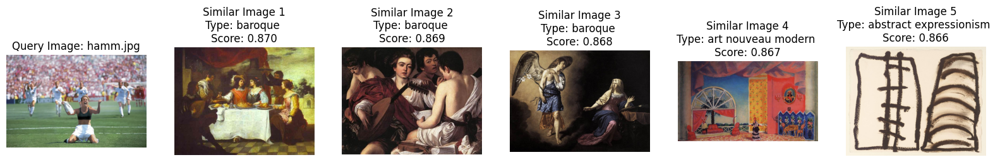

Threshold Masks Results


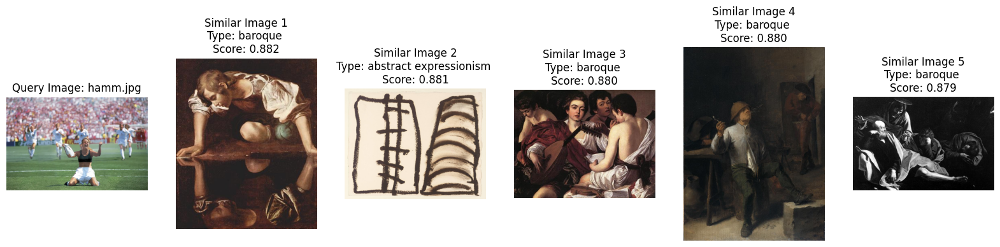

Results for image:  ../data/test-images/tiger.jpg
Dimmed Images Results


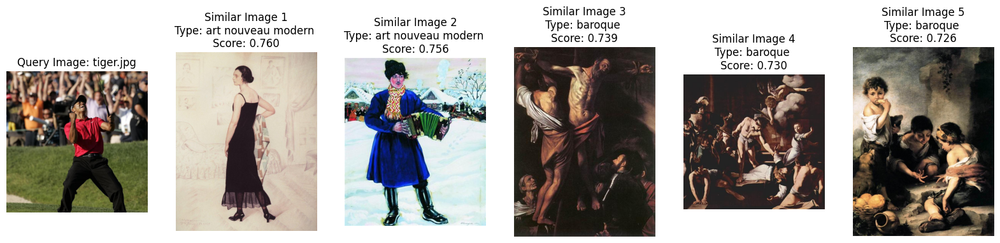

Masks Results


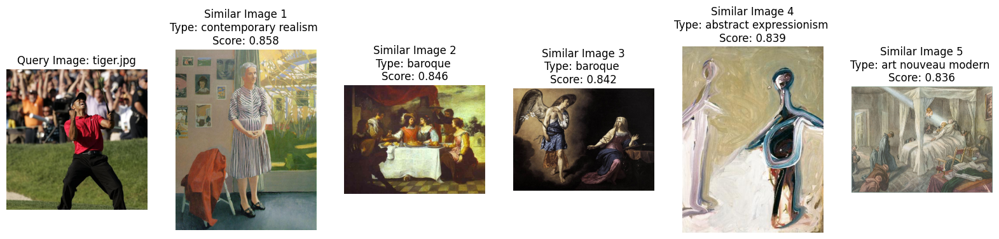

Threshold Masks Results


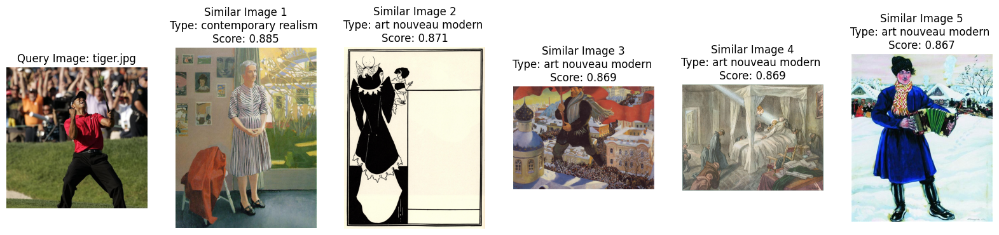

Results for image:  ../data/test-images/the_catch.jpg
Dimmed Images Results


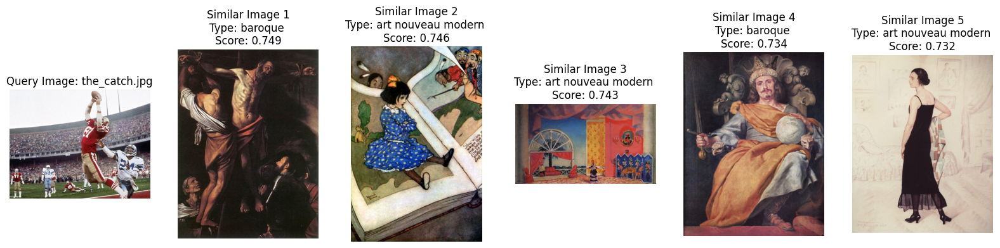

Masks Results


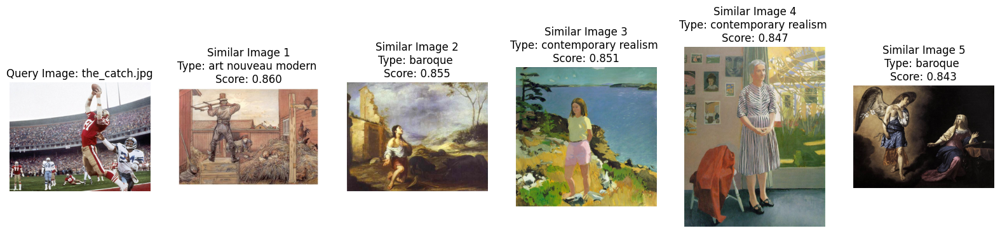

Threshold Masks Results


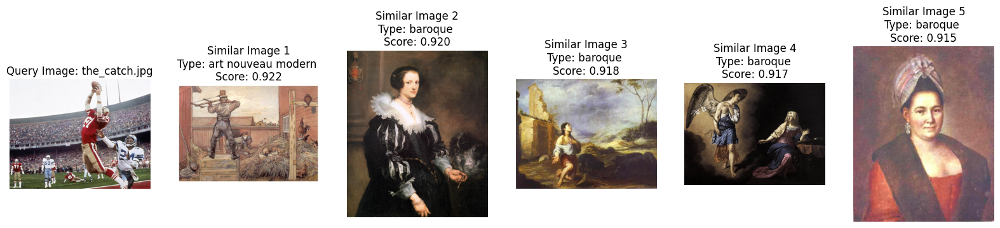

Results for image:  ../data/test-images/ali.jpg
Dimmed Images Results


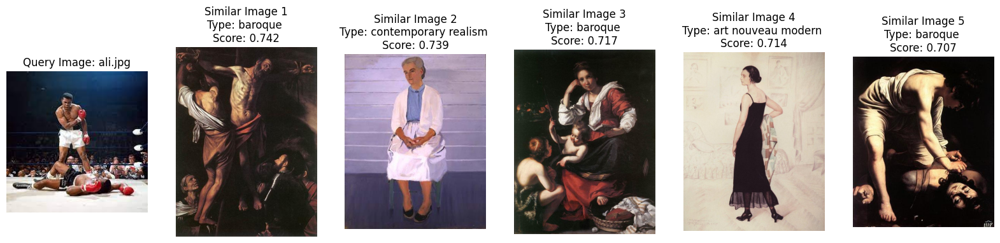

Masks Results


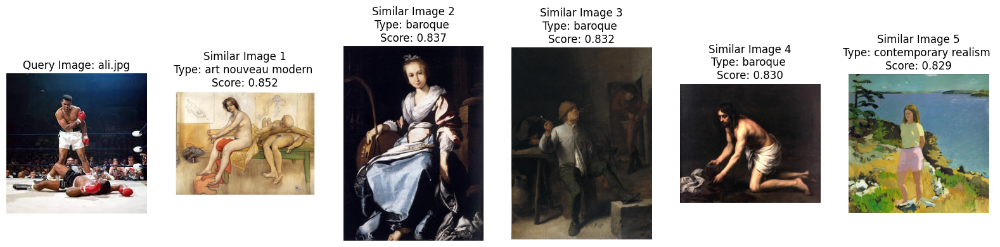

Threshold Masks Results


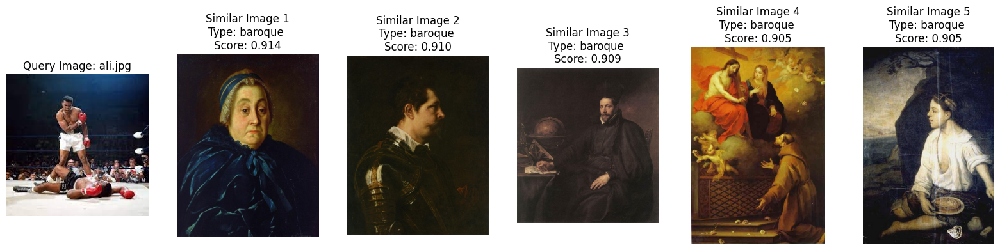

Results for image:  ../data/test-images/jokic.jpg
Dimmed Images Results


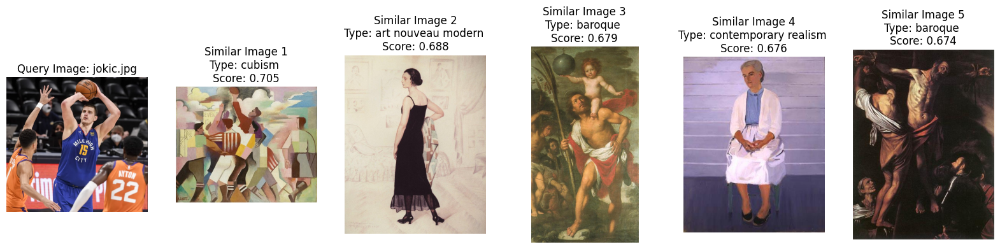

Masks Results


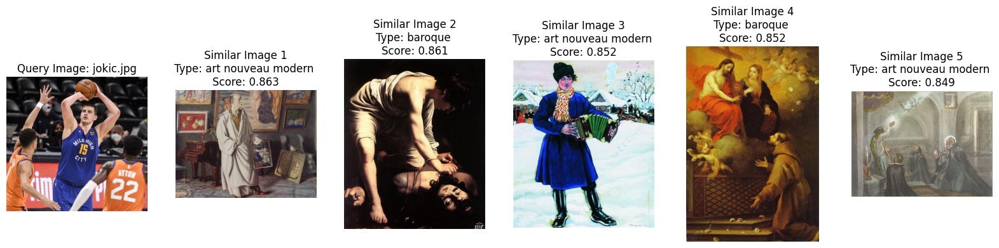

Threshold Masks Results


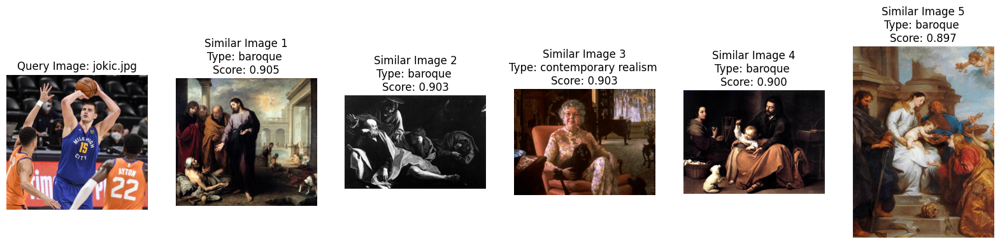

Results for image:  ../data/test-images/jordan.jpg
Dimmed Images Results


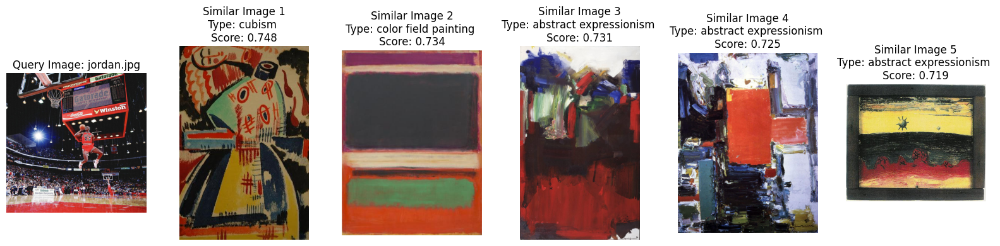

Masks Results


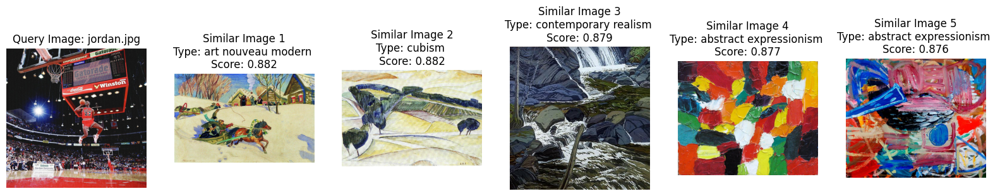

Threshold Masks Results


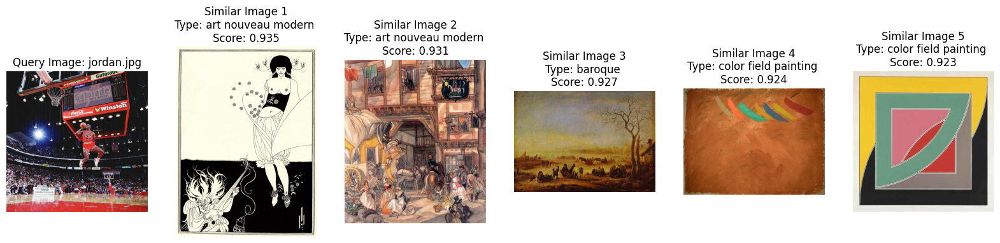

Results for image:  ../data/test-images/tyler_adams.jpg
Dimmed Images Results


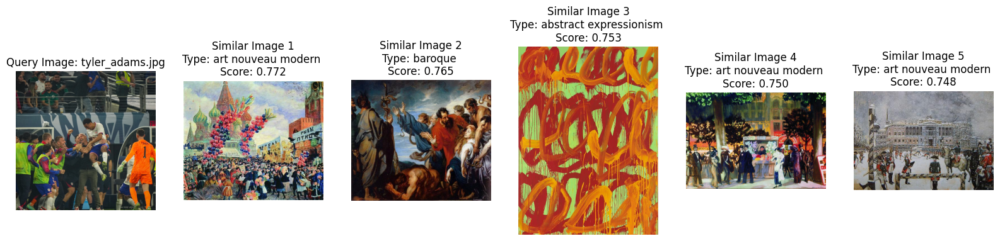

Masks Results


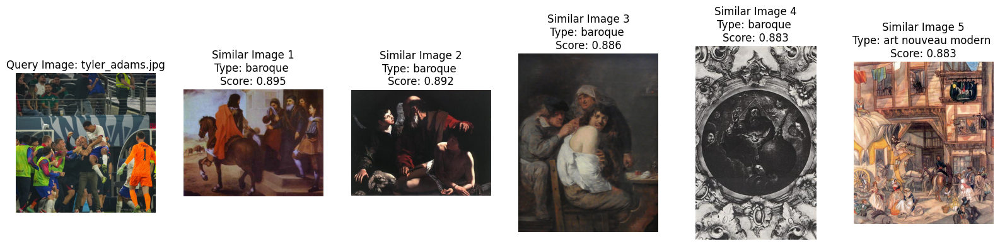

Threshold Masks Results


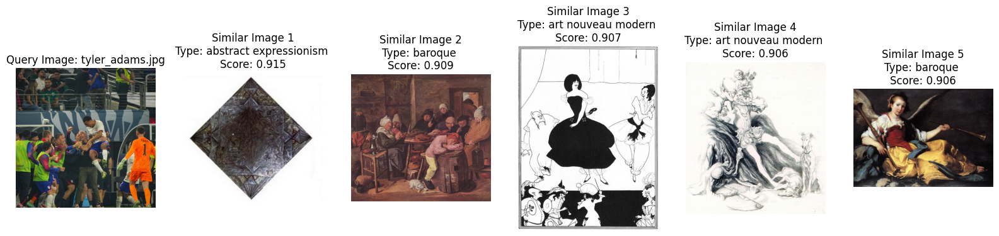

In [34]:
# Get images in test-images folder
test_images = [os.path.join('../data/test-images', item) for item in os.listdir('../data/test-images') if os.path.splitext(item)[-1]=='.jpg']

# Get results for each image
for image in test_images:
    print('Results for image: ', image)

    image_name = os.path.basename(image)
    dimmed_image_path = f'../data/dimmed-test-images/{image_name}'
    mask_image_path = f'../data/mask-test-images/{image_name}'
    threshold_mask_image_path = f'../data/threshold-mask-test-images/{image_name}'

    # Get results for dimmed images
    print("Dimmed Images Results")
    get_real_results(dimmed_image_path, dimmed_vector_store)
    
    # Get results for masks
    print("Masks Results")
    get_real_results(mask_image_path, mask_vector_store)

    # Get results for threshold masks
    print("Threshold Masks Results")
    get_real_results(threshold_mask_image_path, threshold_mask_vector_store)

## Conclusion:

I think the dimmed images are the most promising. The threshold masks get really obscure as in the tyler adams image and the regular masks are good but I think there is something to be said for retaining the colors of the original image which the dimmed images do.

# Next Steps:
- [ ] Run at greater scale to see if the results are consistent with a larger art dataset.

# Cleanup

**DO NOT RUN UNTIL THE END YOU WILL LOSE ALL IMAGES, MASKS, AND VECTOR STORES**

In [42]:
# Remove all unnecessary folders
try:
    os.system('rm -rf images')
except:
    print('Images folder already removed')

try:
    os.system('rm -rf dimmed_images')
except:
    print('Dimmed Images folder already removed')

try:
    os.system('rm -rf masks')
except:
    print('Masks folder already removed')

try:
    os.system('rm -rf threshold-masks')
except:
    print('Threshold Masks folder already removed')

try:
    os.system('rm -rf ../data/dimmed-test-images')

except:
    print('Dimmed Test Images folder already removed')

try:
    os.system('rm -rf ../data/mask-test-images')
except:
    print('Mask Test Images folder already removed')

try:
    os.system('rm -rf ../data/threshold-mask-test-images')
except:
    print('Threshold Mask Test Images folder already removed')

# Remove the vector stores
try:
    os.system(f'rm -r {dimmed_vector_store_path}')
except:
    print('Dimmed Vector Store already removed')

try:
    os.system(f'rm -r {mask_vector_store_path}')
except:
    print('Mask Vector Store already removed')

try:
    os.system(f'rm -r {threshold_mask_vector_store_path}')
except:
    print('Threshold Mask Vector Store already removed')
